In [2]:
import qiskit

In [3]:
qiskit.__version__

'1.1.0'

In [4]:
import numpy as np
from scipy import linalg as lng
import matplotlib.pyplot as plt

In [5]:
# base computacional
v0 = np.array([[1], [0]])
v1 = np.array([[0], [1]])

In [6]:
v0

array([[1],
       [0]])

In [7]:
v1

array([[0],
       [1]])

In [8]:
# estado arbitrário | psi = a.|0> + b.|1>
# |a|^2 + |b|^2 = 1
# a.a^* = |a|^2

psi = np.sqrt(0.7)*v0 + 1j*np.sqrt(0.3)*v1
psi

array([[0.83666003+0.j        ],
       [0.        +0.54772256j]])

In [9]:
had = (1/np.sqrt(2)) * np.array([[1,1],[1,-1]])
had

array([[ 0.70710678,  0.70710678],
       [ 0.70710678, -0.70710678]])

In [10]:
had@v0

array([[0.70710678],
       [0.70710678]])

In [11]:
had@psi

array([[0.59160798+0.38729833j],
       [0.59160798-0.38729833j]])

In [12]:
# dinâmica do estado
psi11 = list() # |a(t)|
psi21 = list() # |b(t)|
time = list()

for k in range(640):
    t = 0.01*k
    U = lng.expm(-1j*had*t)
    psi = U@v0
    
    time.append(t)
    psi11.append(np.abs(psi[0,0]))
    psi21.append(np.abs(psi[1,0]))

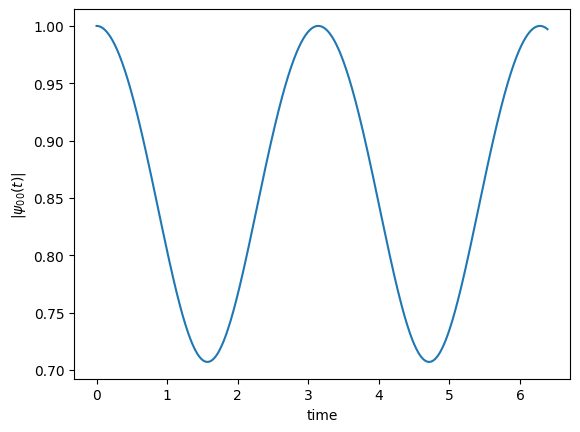

In [13]:
plt.xlabel("time")
plt.ylabel(r"$|\psi_{00}(t)|$")
plt.plot(time, psi11)

In [14]:
from qiskit.visualization import plot_bloch_multivector
import qiskit.quantum_info as qi

In [15]:
v0

array([[1],
       [0]])

In [27]:
state = qi.Statevector(v0)
state.draw("latex")

<IPython.core.display.Latex object>

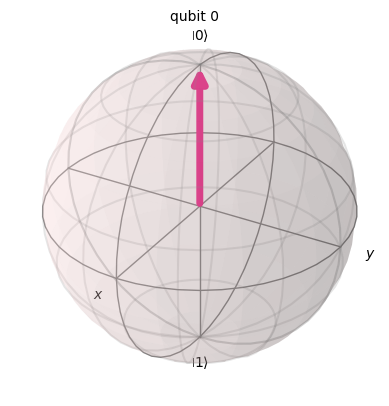

In [17]:
plot_bloch_multivector(state)

In [18]:
psi

array([[9.94300733e-01-0.07538585j],
       [6.74727476e-17-0.07538585j]])

In [28]:
state = qi.Statevector(psi)
state.draw("latex")

<IPython.core.display.Latex object>

In [20]:
had

array([[ 0.70710678,  0.70710678],
       [ 0.70710678, -0.70710678]])

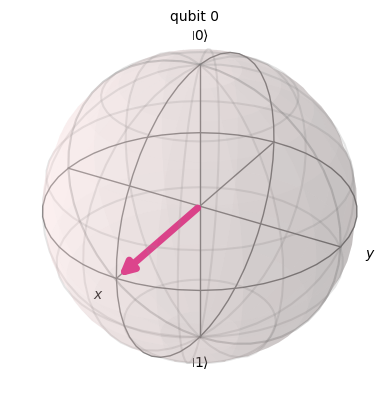

In [21]:
U = lng.expm(1j*had*1.57)
psi = U@v0
state = qi.Statevector(psi)
plot_bloch_multivector(state)

In [22]:
from qiskit import QuantumCircuit
from qiskit.visualization import visualize_transition

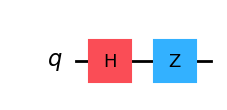

In [23]:
qc = QuantumCircuit(1)
qc.h(0)
qc.z(0)
qc.draw(output="mpl")

In [24]:
visualize_transition(qc, trace=True)